In [1]:
import math
import os
import pickle
import random
import re
import statistics
import time

import folium
import geopandas as gpd
import matplotlib as mpl
import matplotlib.patches as mpatches
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import rioxarray as rxr
import skyfield.toposlib 
import skyfield.units
import uproot
import xarray as xr

from datetime import datetime, timezone
from get_intersections import geographic_position_of_distance, get_pixels_edges_on_surface_arr, get_minieuso_bbox_from_pixels_edges_on_surface_arr, get_minieuso_polygon_from_pixels_edges_on_surface_arr
from geopy.distance import geodesic
from mpl_toolkits.axes_grid1 import make_axes_locatable
from scipy import stats
from shapely.geometry import box, Polygon, Point

Welcome to JupyROOT 6.24/02


#### Get all the file paths in subdirectories

In [2]:
intersections_data_dir = '/home/ubuntu/DP/mini-euso-coordinate-calculations-analysis/intersections_data'

intersections_data_subdirs_list = sorted([f.path for f in os.scandir(intersections_data_dir) if f.is_dir()])

modis_files_list = []
minieuso_files_list = []

# Iterate through all subdirectories of intersections_data directory
for subdir in intersections_data_subdirs_list:
    
    # Setup modis and minieuso dir paths in each subdirectory
    modis_subdir = os.path.join(subdir, 'modis')
    minieuso_subdir = os.path.join(subdir, 'minieuso')
    
    # Read file paths of cloud_mask file, scan_start time and minieuso files
    minieuso_files = sorted([f.path for f in os.scandir(minieuso_subdir)])
    modis_files = [f.path for f in os.scandir(modis_subdir)]
    
    # Check which
    if modis_files[1][-5] == 'e':
        mask_file = modis_files[0]
        ts_file = modis_files[1]
    else:
        mask_file = modis_files[1]
        ts_file = modis_files[0]
        
    for path in modis_files:
        modis_files_list.append(path)
    
    for path in minieuso_files:
        minieuso_files_list.append(path)

    print(mask_file)
    print(ts_file)
    for i in minieuso_files:
        print(i)
    print('\n')

/home/ubuntu/DP/mini-euso-coordinate-calculations-analysis/intersections_data/1/modis/MOD35_L2.A2019332.0205.061.2019332131433.pssg_000501822215-Cloud_Mask-0.tif
/home/ubuntu/DP/mini-euso-coordinate-calculations-analysis/intersections_data/1/modis/MOD35_L2.A2019332.0205.061.2019332131433.pssg_000501822215-Scan_Start_Time.tif
/home/ubuntu/DP/mini-euso-coordinate-calculations-analysis/intersections_data/1/minieuso/CPU_RUN_MAIN__2019_11_28__02_05_59__950Cathode3FullPDMonlyself_l1_v9r2.root
/home/ubuntu/DP/mini-euso-coordinate-calculations-analysis/intersections_data/1/minieuso/CPU_RUN_MAIN__2019_11_28__02_08_10__950Cathode3FullPDMonlyself_l1_v9r2.root
/home/ubuntu/DP/mini-euso-coordinate-calculations-analysis/intersections_data/1/minieuso/CPU_RUN_MAIN__2019_11_28__02_10_22__950Cathode3FullPDMonlyself_l1_v9r2.root


/home/ubuntu/DP/mini-euso-coordinate-calculations-analysis/intersections_data/10/modis/MOD35_L2.A2020074.0320.061.2020074131351.pssg_000501822215-Cloud_Mask-0.tif
/home/ubuntu/

In [3]:
def bits_stripping(bit_start, bit_count, value):
    bitmask=pow(2, bit_start+bit_count)-1
    return np.right_shift(np.bitwise_and(value,bitmask),bit_start)

#### Function for finding the best intersection timestamp

  - returns list of lists, each sublist consists of two values:
        - timestamp difference between Mini-EUSO FoV timestamp and average MODIS Cloud Mask FoV clip timestamp
        - Mini-EUSO FoV timestamp
  - plots intersections between MODIS cloud mask file and each FoV (timestamp) of Mini-EUSO data files (each in different color)

In [4]:
def find_best_intersections(intersections_data_subdirs_list):
    intersections_diff_list = []
    no_intersection_ts_list = []
    
    for subdir in intersections_data_subdirs_list:

        # Setup modis and minieuso dir paths in each subdirectory
        modis_subdir = os.path.join(subdir, 'modis')
        minieuso_subdir = os.path.join(subdir, 'minieuso')

        # Read file paths of cloud_mask file, scan_start time and minieuso files
        minieuso_files = sorted([f.path for f in os.scandir(minieuso_subdir)])
        modis_files = [f.path for f in os.scandir(modis_subdir)]
        if modis_files[1][-5] == 'e':
            mask_file = modis_files[0]
            ts_file = modis_files[1]
        else:
            mask_file = modis_files[1]
            ts_file = modis_files[0]    
        print(f'mask file path: {mask_file}')
        print(f'ts file path: {ts_file}')

        n = re.search('data/(.+?)/modis', mask_file)
        intersection_number = int(n.group(1))

        # Read files with rioxarray
        modis_cloud_mask = rxr.open_rasterio(mask_file)
        modis_ts = rxr.open_rasterio(ts_file)

        # Setup offset for calculating timestamps for modis data
        offset_dt = datetime(1993,1,1)
        offset_utc = offset_dt.replace(tzinfo=timezone.utc)
        offset_utc_ts = offset_utc.timestamp()

        # Calculate Modis (noclip) datetime start and end
        modis_ts_list = sorted(np.unique(modis_ts.values).tolist())
        modis_dt_start = datetime.utcfromtimestamp(offset_utc_ts + int(modis_ts_list[1]))
        modis_dt_end = datetime.utcfromtimestamp(offset_utc_ts + int(modis_ts_list[-1]))

        file_intersections_diff_list = []
        file_no_intersection_ts_list = []
        minieuso_dt_start_list = []
        minieuso_dt_end_list = []         
        colors = [(0.267004, 0.004874, 0.329415, 1.0), (0.993248, 0.906157, 0.143936, 1.0), 'b', 'g', 'r', 'c', 'm', 'y', 'w', 'k']

        # Compute binary cloud mask by reading first two bits
        noclip_binary_mask = []
        for pixel in modis_cloud_mask.values[0].reshape(-1):
            if int(pixel) == 0:
                noclip_binary_mask.append(0)
            else:
                if bits_stripping(1,2, pixel) <= 1:
                    noclip_binary_mask.append(1)
                else:
                    noclip_binary_mask.append(0)

        noclip_binary_mask_arr = np.asarray(noclip_binary_mask)
        noclip_binary_mask_arr_reshaped = noclip_binary_mask_arr.reshape((len(modis_cloud_mask.y.values), len(modis_cloud_mask.x.values)))


        # Plot subdirectory data
        plt.figure(figsize=(8,8))

        # Iterate Mini-EUSO files
        color=2 # For colors
        for f in minieuso_files:
            D3_events = uproot.open(f+':tevent_2nd_integral')
            D3_events_ts_arr = D3_events['timestamp_unix'].array(library='np')
            minieuso_dt_start_list.append(datetime.utcfromtimestamp(D3_events_ts_arr[0]))
            minieuso_dt_end_list.append(datetime.utcfromtimestamp(D3_events_ts_arr[-1]))

            ts_list = []
            for i in range(len(D3_events_ts_arr)):
                ts_list.append(int(D3_events_ts_arr[i]))        
            ts_list_sorted = sorted(list(set(ts_list)))

            # Each ts is a FoV of Mini-EUSO
            for ts in ts_list_sorted:
                pixels_edges = get_pixels_edges_on_surface_arr(ts)
                fov_polygon = get_minieuso_polygon_from_pixels_edges_on_surface_arr(pixels_edges)
                fov_polygon_coords = list(fov_polygon.geometry[0].exterior.coords)
                fov_x = [i for i,j in fov_polygon_coords]
                fov_y = [j for i,j in fov_polygon_coords]
                plt.plot(fov_x, fov_y, colors[color], linewidth=3)

                try:
                    modis_fov_time_clip = rxr.open_rasterio(ts_file).rio.clip(fov_polygon.geometry,
                                                                              all_touched=True,
                                                                              from_disk=True)
                    modis_fov_ts_list = sorted(np.unique(modis_fov_time_clip.values).tolist())
                    modis_fov_dt_start = datetime.utcfromtimestamp(offset_utc_ts + int(modis_fov_ts_list[2]))
                    modis_fov_dt_end = datetime.utcfromtimestamp(offset_utc_ts + int(modis_fov_ts_list[-1]))
                    modis_fov_dt_midpoint = modis_fov_dt_start + (modis_fov_dt_end - modis_fov_dt_start)/2
                    minieuso_fov_dt = datetime.utcfromtimestamp(ts)
                    intersection_diff = (modis_fov_dt_midpoint - minieuso_fov_dt).total_seconds()
                    file_intersections_diff_list.append([intersection_diff, ts])
                except Exception as e:
                    file_no_intersection_ts_list.append(ts)

            # Increment i to change color for the next Mini-EUSO file      
            color+=1 

        im = plt.imshow(noclip_binary_mask_arr_reshaped, extent = [modis_cloud_mask.x.values.min(), modis_cloud_mask.x.values.max(), modis_cloud_mask.y.values.min(), modis_cloud_mask.y.values.max()], interpolation='none')
        values = np.array([0,1])
        patches = [ mpatches.Patch(color=colors[0], label='Clear'),
                    mpatches.Patch(color=colors[1], label='Cloudy'),
                    mpatches.Patch(color=colors[2], label='Data 1'),
                    mpatches.Patch(color=colors[3], label='Data 2'),
                    mpatches.Patch(color=colors[4], label='Data 3'),
                    mpatches.Patch(color=colors[5], label='Data 4'),
                    mpatches.Patch(color=colors[6], label='Data 5'),
                    mpatches.Patch(color=colors[7], label='Data 6'),
                    mpatches.Patch(color=colors[8], label='Data 7')]

        plt.legend(handles=patches, bbox_to_anchor=(1.01, 1), loc=2, borderaxespad=0. )
        plt.xlabel("Longitude [deg]", fontweight ='bold')
        plt.ylabel("Latitude [deg]", fontweight ='bold')
        plt.title(f'MODIS 5-min granule 1km Cloud Mask with Mini-EUSO Data Intersections \n Intersection number: {intersection_number} \n MODIS granule: {modis_dt_start} - {modis_dt_end} \n Mini-EUSO files: {minieuso_dt_start_list[0]} - {minieuso_dt_end_list[-1]}', fontweight ="bold")
        plt.show()

        intersections_diff_list.append(file_intersections_diff_list)
        no_intersection_ts_list.append(file_no_intersection_ts_list)
    
    return intersections_diff_list

mask file path: /home/ubuntu/DP/mini-euso-coordinate-calculations-analysis/intersections_data/1/modis/MOD35_L2.A2019332.0205.061.2019332131433.pssg_000501822215-Cloud_Mask-0.tif
ts file path: /home/ubuntu/DP/mini-euso-coordinate-calculations-analysis/intersections_data/1/modis/MOD35_L2.A2019332.0205.061.2019332131433.pssg_000501822215-Scan_Start_Time.tif


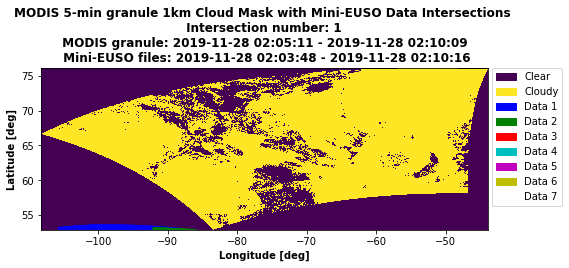

mask file path: /home/ubuntu/DP/mini-euso-coordinate-calculations-analysis/intersections_data/10/modis/MOD35_L2.A2020074.0320.061.2020074131351.pssg_000501822215-Cloud_Mask-0.tif
ts file path: /home/ubuntu/DP/mini-euso-coordinate-calculations-analysis/intersections_data/10/modis/MOD35_L2.A2020074.0320.061.2020074131351.pssg_000501822215-Scan_Start_Time.tif


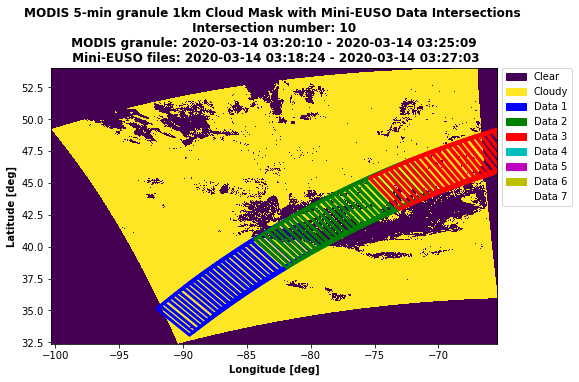

mask file path: /home/ubuntu/DP/mini-euso-coordinate-calculations-analysis/intersections_data/11/modis/MYD35_L2.A2020091.2320.061.2020092152214.pssg_000501822215-Cloud_Mask-0.tif
ts file path: /home/ubuntu/DP/mini-euso-coordinate-calculations-analysis/intersections_data/11/modis/MYD35_L2.A2020091.2320.061.2020092152214.pssg_000501822215-Scan_Start_Time.tif


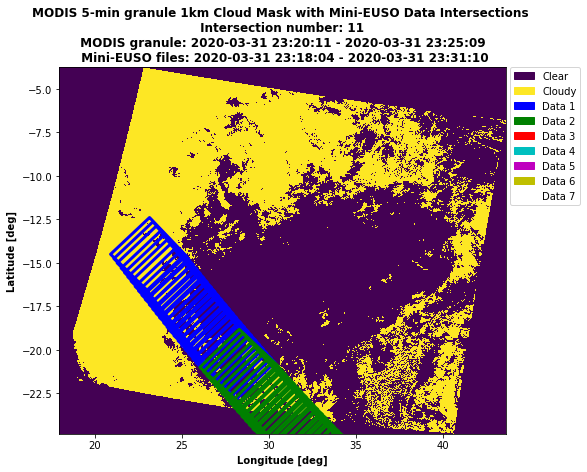

mask file path: /home/ubuntu/DP/mini-euso-coordinate-calculations-analysis/intersections_data/12/modis/MYD35_L2.A2020091.2325.061.2020092152217.pssg_000501822215-Cloud_Mask-0.tif
ts file path: /home/ubuntu/DP/mini-euso-coordinate-calculations-analysis/intersections_data/12/modis/MYD35_L2.A2020091.2325.061.2020092152217.pssg_000501822215-Scan_Start_Time.tif


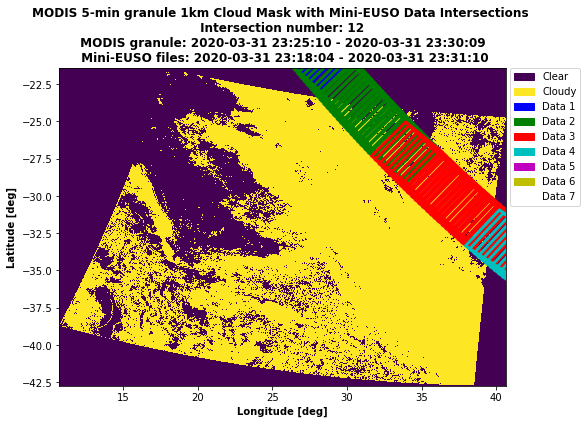

mask file path: /home/ubuntu/DP/mini-euso-coordinate-calculations-analysis/intersections_data/13/modis/MYD35_L2.A2020147.0735.061.2020147234322.pssg_000501822215-Cloud_Mask-0.tif
ts file path: /home/ubuntu/DP/mini-euso-coordinate-calculations-analysis/intersections_data/13/modis/MYD35_L2.A2020147.0735.061.2020147234322.pssg_000501822215-Scan_Start_Time.tif


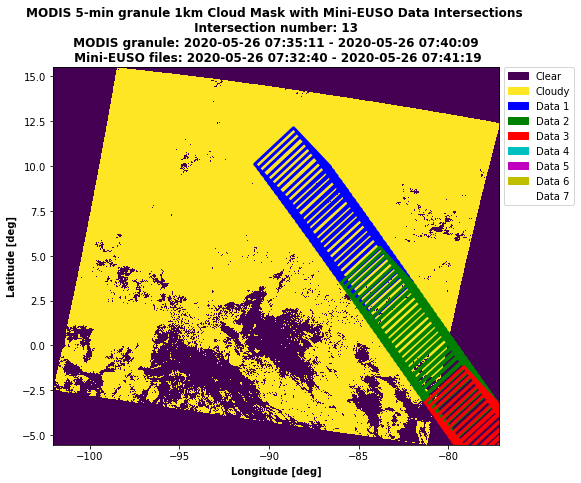

mask file path: /home/ubuntu/DP/mini-euso-coordinate-calculations-analysis/intersections_data/2/modis/MOD35_L2.A2019332.0340.061.2019332131546.pssg_000501822215-Cloud_Mask-0.tif
ts file path: /home/ubuntu/DP/mini-euso-coordinate-calculations-analysis/intersections_data/2/modis/MOD35_L2.A2019332.0340.061.2019332131546.pssg_000501822215-Scan_Start_Time.tif


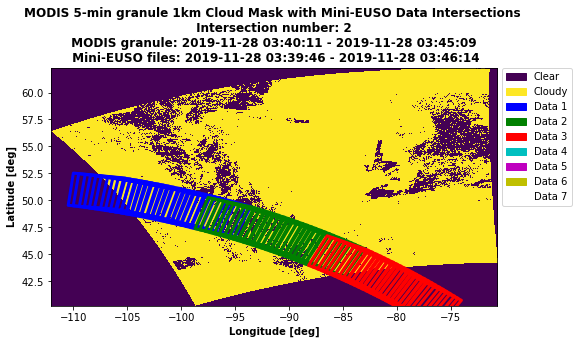

mask file path: /home/ubuntu/DP/mini-euso-coordinate-calculations-analysis/intersections_data/3/modis/MOD35_L2.A2019332.0515.061.2019332131419.pssg_000501822215-Cloud_Mask-0.tif
ts file path: /home/ubuntu/DP/mini-euso-coordinate-calculations-analysis/intersections_data/3/modis/MOD35_L2.A2019332.0515.061.2019332131419.pssg_000501822215-Scan_Start_Time.tif


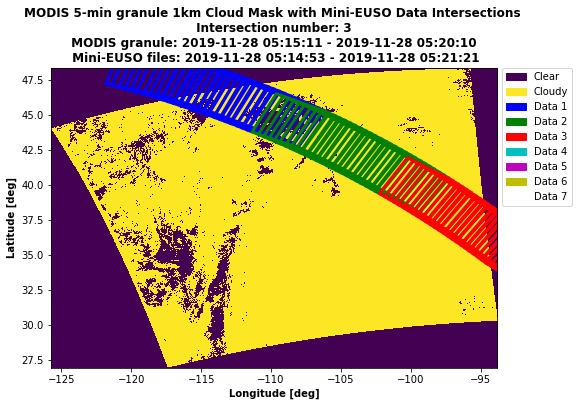

mask file path: /home/ubuntu/DP/mini-euso-coordinate-calculations-analysis/intersections_data/4/modis/MOD35_L2.A2019339.2140.061.2019340071959.pssg_000501822215-Cloud_Mask-0.tif
ts file path: /home/ubuntu/DP/mini-euso-coordinate-calculations-analysis/intersections_data/4/modis/MOD35_L2.A2019339.2140.061.2019340071959.pssg_000501822215-Scan_Start_Time.tif


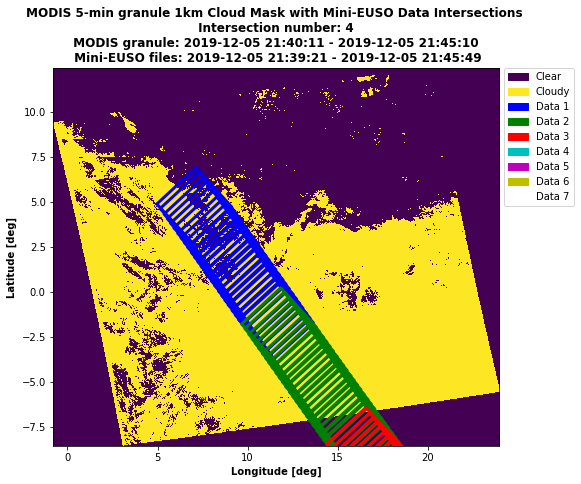

mask file path: /home/ubuntu/DP/mini-euso-coordinate-calculations-analysis/intersections_data/5/modis/MYD35_L2.A2019365.0340.061.2019365163451.pssg_000501822215-Cloud_Mask-0.tif
ts file path: /home/ubuntu/DP/mini-euso-coordinate-calculations-analysis/intersections_data/5/modis/MYD35_L2.A2019365.0340.061.2019365163451.pssg_000501822215-Scan_Start_Time.tif


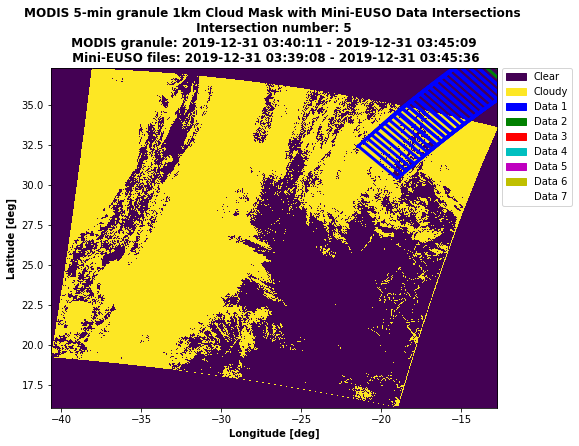

mask file path: /home/ubuntu/DP/mini-euso-coordinate-calculations-analysis/intersections_data/6/modis/MYD35_L2.A2019365.0515.061.2019365170204.pssg_000501822215-Cloud_Mask-0.tif
ts file path: /home/ubuntu/DP/mini-euso-coordinate-calculations-analysis/intersections_data/6/modis/MYD35_L2.A2019365.0515.061.2019365170204.pssg_000501822215-Scan_Start_Time.tif


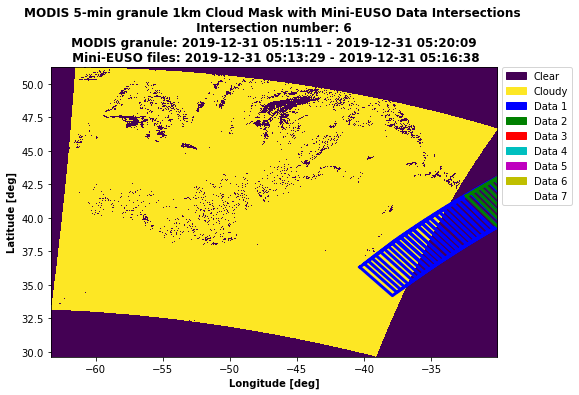

mask file path: /home/ubuntu/DP/mini-euso-coordinate-calculations-analysis/intersections_data/7/modis/MYD35_L2.A2020052.2000.061.2020053171415.pssg_000501822215-Cloud_Mask-0.tif
ts file path: /home/ubuntu/DP/mini-euso-coordinate-calculations-analysis/intersections_data/7/modis/MYD35_L2.A2020052.2000.061.2020053171415.pssg_000501822215-Scan_Start_Time.tif


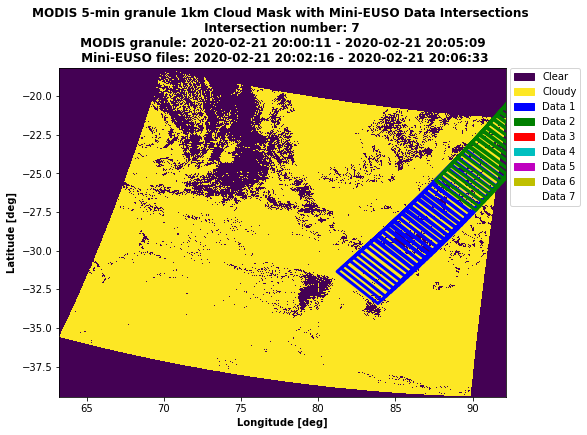

mask file path: /home/ubuntu/DP/mini-euso-coordinate-calculations-analysis/intersections_data/8/modis/MYD35_L2.A2020062.1845.061.2020063154710.pssg_000501822215-Cloud_Mask-0.tif
ts file path: /home/ubuntu/DP/mini-euso-coordinate-calculations-analysis/intersections_data/8/modis/MYD35_L2.A2020062.1845.061.2020063154710.pssg_000501822215-Scan_Start_Time.tif


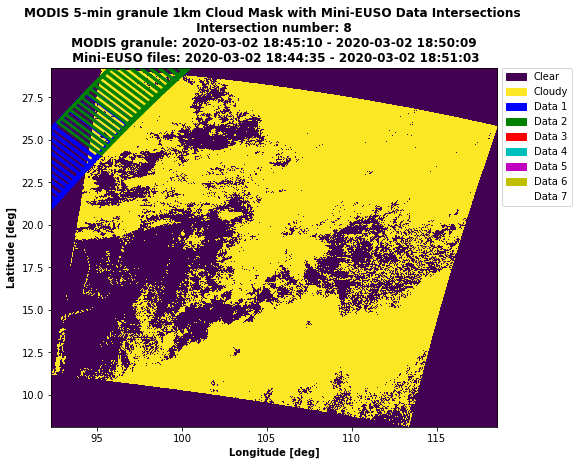

mask file path: /home/ubuntu/DP/mini-euso-coordinate-calculations-analysis/intersections_data/9/modis/MYD35_L2.A2020062.2020.061.2020063155103.pssg_000501822215-Cloud_Mask-0.tif
ts file path: /home/ubuntu/DP/mini-euso-coordinate-calculations-analysis/intersections_data/9/modis/MYD35_L2.A2020062.2020.061.2020063155103.pssg_000501822215-Scan_Start_Time.tif


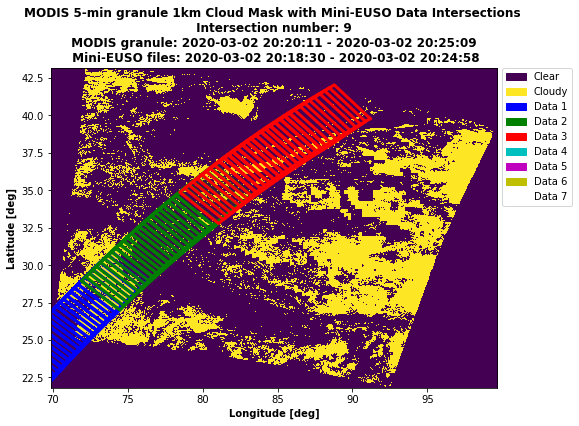

In [5]:
intersections_diff_list = find_best_intersections(intersections_data_subdirs_list)

- This way we can filter timestamps in which timestamp difference was less than x seconds

In [6]:
intersections_diff_lt5_list = []
intersections_diff_lt30_list = []
intersections_diff_lt60_list = []

for sublist in intersections_diff_list:
    for ele in sublist:
        if abs(ele[0]) < 5:
            intersections_diff_lt5_list.append(ele)
            
for sublist in intersections_diff_list:
    for ele in sublist:
        if abs(ele[0]) < 30:
            intersections_diff_lt30_list.append(ele)

for sublist in intersections_diff_list:
    for ele in sublist:
        if abs(ele[0]) < 60:
            intersections_diff_lt60_list.append(ele)

intersections_diff_lt5_list

[[3.0, 1584156156],
 [1.0, 1584156161],
 [-2.5, 1584156166],
 [-1.0, 1574912522],
 [-1.0, 1574918308],
 [-2.5, 1575582097],
 [-0.5, 1577763617],
 [1.0, 1582315362],
 [4.0, 1583174780],
 [-3.0, 1583174785],
 [1.5, 1583180551]]

In [7]:
intersections_diff_lt5_dt_list = sorted([datetime.utcfromtimestamp(ele[1]) for ele in intersections_diff_lt5_list])
intersections_diff_lt30_dt_list = sorted([datetime.utcfromtimestamp(ele[1]) for ele in intersections_diff_lt30_list])
intersections_diff_lt60_dt_list = sorted([datetime.utcfromtimestamp(ele[1]) for ele in intersections_diff_lt60_list])

for dt in intersections_diff_lt5_dt_list:
    print(dt)

2019-11-28 03:42:02
2019-11-28 05:18:28
2019-12-05 21:41:37
2019-12-31 03:40:17
2020-02-21 20:02:42
2020-03-02 18:46:20
2020-03-02 18:46:25
2020-03-02 20:22:31
2020-03-14 03:22:36
2020-03-14 03:22:41
2020-03-14 03:22:46


In [8]:
intersections_diff_lt5_ts_list = sorted([ele[1] for ele in intersections_diff_lt5_list])
intersections_diff_lt30_ts_list = sorted([ele[1] for ele in intersections_diff_lt30_list])
intersections_diff_lt60_ts_list = sorted([ele[1] for ele in intersections_diff_lt60_list])

for ts in intersections_diff_lt5_ts_list:
    print(ts)

1574912522
1574918308
1575582097
1577763617
1582315362
1583174780
1583174785
1583180551
1584156156
1584156161
1584156166


#### Functions for getting MODIS file paths by timestamp

In [9]:
modis_files_dt_list = []
for filepath in modis_files_list:
    m = re.search('L2.A(.+?).061', filepath)
    n = re.search('data/(.+?)/modis', filepath)
    if m:
        found = m.group(1)
        modis_file_dt = datetime.strptime(found, '%Y%j.%H%M')
        modis_files_dt_list.append(modis_file_dt)
    
modis_files_dt_list.sort()
modis_files_dt_list_nodupes = list(dict.fromkeys(modis_files_dt_list))
modis_files_dt_list_nodupes

[datetime.datetime(2019, 11, 28, 2, 5),
 datetime.datetime(2019, 11, 28, 3, 40),
 datetime.datetime(2019, 11, 28, 5, 15),
 datetime.datetime(2019, 12, 5, 21, 40),
 datetime.datetime(2019, 12, 31, 3, 40),
 datetime.datetime(2019, 12, 31, 5, 15),
 datetime.datetime(2020, 2, 21, 20, 0),
 datetime.datetime(2020, 3, 2, 18, 45),
 datetime.datetime(2020, 3, 2, 20, 20),
 datetime.datetime(2020, 3, 14, 3, 20),
 datetime.datetime(2020, 3, 31, 23, 20),
 datetime.datetime(2020, 3, 31, 23, 25),
 datetime.datetime(2020, 5, 26, 7, 35)]

In [10]:
def nearest(items, pivot):
    return min(items, key=lambda x: abs(x - pivot))

In [11]:
def get_modis_files_from_ts(ts):
    mask_file = None
    ts_file = None
    
    nearest_modis_dt = nearest(modis_files_dt_list_nodupes, datetime.utcfromtimestamp(ts))
    intersection_num = modis_files_dt_list_nodupes.index(nearest_modis_dt) + 1
    modis_files_dir_path = os.path.join(intersections_data_dir, str(intersection_num), 'modis')
    modis_files_list = [f.path for f in os.scandir(modis_files_dir_path)]
    if modis_files_list[1][-5] == 'e':
        mask_file = modis_files_list[0]
        ts_file = modis_files_list[1]
    else:
        mask_file = modis_files_list[1]
        ts_file = modis_files_list[0]
    return mask_file, ts_file

#### Function for calculating Cloud Mask of Mini-EUSO FoV from MODIS tif file

- copied from the previous Mini-EUSO Cloud Mapping jupyter notebook

In [12]:
def get_cloudmask_of_minieuso_fov(minieuso_pixels_edges, modis_tif):
    start_time = datetime.now()
    res_mask = []
    
    # For each pixel edges array of pixel of 48x48 Mini-EUSO FoV 
    for pixel_edges_arr in minieuso_pixels_edges.reshape((-1, 5, 3)):
        pixel_lons = []
        pixel_lats = []
        
        # Calculate bounding box of the pixel according to its edges ([0] is center so we can omit it)
        for edge in pixel_edges_arr[1:]:
            pixel_edge_geographic_position = geographic_position_of_distance(
                skyfield.toposlib.wgs84, 
                skyfield.units.Distance(km=edge))
            pixel_lons.append(pixel_edge_geographic_position.longitude.degrees)
            pixel_lats.append(pixel_edge_geographic_position.latitude.degrees)

        # Get bounding box (minLon, minLat, maxLon, maxLat) of given pixel
        pixel_bbox = [box(min(pixel_lons), min(pixel_lats), max(pixel_lons), max(pixel_lats))]
        
        # Get LatLon coordinates of the pixel center         
        pixel_center_latlon = (geographic_position_of_distance(skyfield.toposlib.wgs84, skyfield.units.Distance(km=pixel_edges_arr[0])).latitude.degrees,
                               geographic_position_of_distance(skyfield.toposlib.wgs84, skyfield.units.Distance(km=pixel_edges_arr[0])).longitude.degrees)
        
        # Crop MODIS Cloud Mask data to pixel bounding box with rioxarray
        try:
            modis_cloud_mask_clip = rxr.open_rasterio(modis_tif, masked=True).rio.clip(pixel_bbox,
                                                                                       all_touched=True,
                                                                                       from_disk=True)


            pixel_corr_modis_pixels_values_list = []

            # Iterate through Modis clip pixels
            for iy, ix  in np.ndindex(modis_cloud_mask_clip.values[0].shape):
                # Get center coordinates of each pixel
                current_modis_pixel_center_latlon = (modis_cloud_mask_clip[0].y[iy].item(), modis_cloud_mask_clip[0].x[ix].item())
                # Calculate geodesic distance of the modis pixel to the center of the minieuso pixel
                # If the distance is less than 2.8km, we count this pixel as a part of minieuso pixel
                if geodesic(current_modis_pixel_center_latlon, pixel_center_latlon).kilometers < 2.8:
                    # Read 1 and 2 bits and read the value according to docs: 0,1 - Cloudy, 2,3 - Clear
                    if bits_stripping(1,2, modis_cloud_mask_clip[0, iy, ix].item()) <= 1:
                        pixel_corr_modis_pixels_values_list.append(1)
                    else:
                        pixel_corr_modis_pixels_values_list.append(0)

            # if most of the MODIS pixels assigned to Mini-EUSO pixel are cloudy, we flag this pixel as cloudy
            if (sum(pixel_corr_modis_pixels_values_list)/len(pixel_corr_modis_pixels_values_list)) >= 0.5:
                res_mask.append(1)
            else:
                res_mask.append(0)
        except Exception as e:
            res_mask.append(-1)
    
    # Return the result binary mask (list with 2304 (48x48) values)
    print('Done. Time elapsed (hh:mm:ss.ms): {}'.format(datetime.now() - start_time))
    return res_mask

#### Functions for plotting computed cloud masks and Mini-EUSO photon count data on Mini-EUSO pixels

In [13]:
def plot_minieuso_cloud_mask_data_pixels(modis_time_file, minieuso_data_ts, mask, data_index):

    minieuso_pixels_edges_arr = get_pixels_edges_on_surface_arr(minieuso_data_ts)
    
    fov_polygon = get_minieuso_polygon_from_pixels_edges_on_surface_arr(minieuso_pixels_edges_arr)
    fov_modis_time_polygon_clip = rxr.open_rasterio(modis_time_file).rio.clip(fov_polygon.geometry,
                                                                              all_touched=True,
                                                                              from_disk=True)
    
    offset_dt = datetime(1993,1,1)
    offset_utc = offset_dt.replace(tzinfo=timezone.utc)
    offset_utc_ts = offset_utc.timestamp()

    modis_fov_ts_list = sorted(np.unique(fov_modis_time_polygon_clip.values).tolist())
    modis_fov_dt_start = datetime.utcfromtimestamp(offset_utc_ts + int(modis_fov_ts_list[2]))
    modis_fov_dt_end = datetime.utcfromtimestamp(offset_utc_ts + int(modis_fov_ts_list[-1]))
    modis_fov_dt_midpoint = modis_fov_dt_start + (modis_fov_dt_end - modis_fov_dt_start)/2
    
    fig, ax = plt.subplots(figsize=(8,8))
    i=0

    for points_arr in minieuso_pixels_edges_arr.reshape((-1, 5, 3)):
        geographic_position = geographic_position_of_distance(
            skyfield.toposlib.wgs84, 
            skyfield.units.Distance(km=points_arr[0])
        )
        lon = geographic_position.longitude.degrees
        lat = geographic_position.latitude.degrees
        values = np.array([0,1])
        colors = [(0.267004, 0.004874, 0.329415, 1.0), (0.993248, 0.906157, 0.143936, 1.0)]
        patches = [ mpatches.Patch(color=colors[0], label="Clear".format(l=values[0])),
                    mpatches.Patch(color=colors[1], label="Cloudy".format(l=values[1])) ]
        plt.legend(handles=patches, bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0. )
        if mask[i] == 0:
            c = colors[0]
        else:
            c = colors[1]

        x = []
        y = []

        for point in points_arr[1:]:
            geographic_position = geographic_position_of_distance(skyfield.toposlib.wgs84, skyfield.units.Distance(km=point))
            x.append(geographic_position.longitude.degrees)
            y.append(geographic_position.latitude.degrees)

        ax.fill(x, y, color=c)
        i+=1

    ax.set_facecolor('black')
    ax.set_xlabel('Longitude [deg]', fontweight ='bold')
    ax.set_ylabel('Latitude [deg]', fontweight ='bold')
    plt.title(f'Test Mini-EUSO pixels with mapped MODIS Cloud Mask data\n index: {data_index}\n {modis_fov_dt_midpoint}', fontweight ='bold')
    plt.show()

In [14]:
def plot_minieuso_photon_count_pixels(minieuso_file, index):
    eventsD3 = uproot.open(minieuso_file+':tevent_2nd_integral')
    photon_count_arr = eventsD3['photon_count_data'].array(library='np')
    ts_arr = eventsD3['timestamp_unix'].array(library='np')
    minieuso_data_ts = ts_arr[index]
    minieuso_photon_data = photon_count_arr[:,0,0,:,:].reshape(3200, -1)[index]
    minieuso_pixels_edges_arr = get_pixels_edges_on_surface_arr(minieuso_data_ts)
    minval = np.min(minieuso_photon_data[np.nonzero(minieuso_photon_data)])
    maxval = np.max(minieuso_photon_data[np.nonzero(minieuso_photon_data)])
    minieuso_data_dt = datetime.utcfromtimestamp(minieuso_data_ts)

    norm = mpl.colors.Normalize(vmin=minval, vmax=maxval, clip=True)
    cm_mapper = mpl.cm.ScalarMappable(norm=norm, cmap=mpl.cm.viridis)

    fig, ax = plt.subplots(figsize=(8,8))

    divider = make_axes_locatable(ax)
    cax = divider.append_axes('right',size='5%',pad=0.05)

    i = 0

    for points_arr in minieuso_pixels_edges_arr.reshape((-1, 5, 3)):
        geographic_position = geographic_position_of_distance(
            skyfield.toposlib.wgs84, 
            skyfield.units.Distance(km=points_arr[0])
        )
        lon = geographic_position.longitude.degrees
        lat = geographic_position.latitude.degrees
        c = cm_mapper.to_rgba(minieuso_photon_data[i])


        x = []
        y = []

        for point in points_arr[1:]:
            geographic_position = geographic_position_of_distance(skyfield.toposlib.wgs84, skyfield.units.Distance(km=point))
            x.append(geographic_position.longitude.degrees)
            y.append(geographic_position.latitude.degrees)

        ax.fill(x, y, color=c)
        i+=1

    fig.colorbar(cm_mapper, cax=cax)

    ax.set_xlabel('Longitude [deg]', fontweight ='bold')
    ax.set_ylabel('Latitude [deg]', fontweight ='bold')
    ax.set_title(f'Mini-EUSO photon_count_data\n index: {index}\n {minieuso_data_dt}', fontweight ='bold')

    plt.show()

#### Computing Cloud Masks of the best timestamps

In [15]:
len(intersections_diff_lt5_ts_list), len(intersections_diff_lt30_ts_list), len(intersections_diff_lt60_ts_list)

(11, 66, 129)

In [ ]:
mapped_cm_list_lt5 = []

for ts in intersections_diff_lt5_ts_list:
    print(f'Generating cloud mask of FoV in timestamp {ts}, datetime: {datetime.utcfromtimestamp(ts)}')
    pixels_edges = get_pixels_edges_on_surface_arr(ts)
    modis_cm_file, modis_ts_file = get_modis_files_from_ts(ts)
    fov_cm = get_cloudmask_of_minieuso_fov(pixels_edges, modis_cm_file)
    mapped_cm_list_lt5.append([fov_cm, ts])
    print('\n')

In [ ]:
mapped_cm_list_lt60 = []

for ts in intersections_diff_lt60_ts_list:
    print(f'Generating cloud mask of FoV in timestamp {ts}, datetime: {datetime.utcfromtimestamp(ts)}')
    pixels_edges = get_pixels_edges_on_surface_arr(ts)
    modis_cm_file, modis_ts_file = get_modis_files_from_ts(ts)
    fov_cm = get_cloudmask_of_minieuso_fov(pixels_edges, modis_cm_file)
    mapped_cm_list_lt60.append([fov_cm, ts])
    print('\n')

In [ ]:
with open('mapped_cm_list_lt60.pkl', 'wb') as f:
    pickle.dump(mapped_cm_list_lt60, f)

- since this operations takes a long time, we saved the final list to pickle and we can just load it now

In [16]:
with open('mapped_cm_list_lt60.pkl', 'rb') as f:
    mapped_cm_list_lt60 = pickle.load(f)

- filter masks which contain '-1', which means that they are not fully in intersection with MODIS Cloud Mask

In [17]:
mapped_cm_list_lt60_filtered = []
counter = 0

for sublist in mapped_cm_list_lt60:
    if any(-1 in i for i in sublist if isinstance(i, list)):
        counter+=1
    else:
        mapped_cm_list_lt60_filtered.append(sublist)
        
print(f'number of sublists that contains -1: {counter}')
len(mapped_cm_list_lt60_filtered)

number of sublists that contains -1: 25


104

- put timestamps, datetimes and masks in separate lists

In [18]:
mapped_cm_list_lt60_ts_list = [item[1] for item in mapped_cm_list_lt60_filtered]
mapped_cm_list_lt60_dt_list = [datetime.utcfromtimestamp(ts) for ts in mapped_cm_list_lt60_ts_list]
mapped_cm_list_lt60_cm_list = [item[0] for item in mapped_cm_list_lt60_filtered]

#### Functions for getting Mini-EUSO file path by timestamp

In [20]:
df = pd.read_csv('files_timestamps_best_label_diff_df.csv')

In [21]:
def format_date(date):
    part1 = date[0:10]
    part2 = date[12:20]
    part1_corrected = part1[0:4] + '-' + part1[5:7] + '-' + part1[8:10]
    part2_corrected = part2[0:2] + ':' + part2[3:5] + ':' + part2[6:8]
    res = part1_corrected + ' ' + part2_corrected
    return res

In [22]:
def get_intervals(minieuso_files_list):
    res_intervals = []
    for filepath in minieuso_files_list:
        r1 = re.search('N__(.+?)__950', filepath)                    
        r2 = re.search('N__(.+?)__1000', filepath)
        
        if r1:
            date_base = r1.group(1)
            date = format_date(date_base)
            ts_low = df[df['datetime'].str.contains(date)]['timestamp_low'].iloc[0]
            ts_high = df[df['datetime'].str.contains(date)]['timestamp_high'].iloc[0]
            res_intervals.append([ts_low, ts_high])
       
        if r2:
            date_base = r2.group(1)
            date = format_date(date_base)
            ts_low = df[df['datetime'].str.contains(date)]['timestamp_low'].iloc[0]
            ts_high = df[df['datetime'].str.contains(date)]['timestamp_high'].iloc[0]
            res_intervals.append([ts_low, ts_high])
            
    return res_intervals

In [23]:
def get_minieuso_file_from_ts(ts):
    intervals = get_intervals(minieuso_files_list)
    for i in range(len(intervals)):
        if intervals[i][0] <= ts <= intervals[i][1]:
            return minieuso_files_list[i]

#### Functions for calculating correlation coefficients between mask and mini-euso photon data matrices

In [24]:
def calculate_correlations(mapped_cm_ts_list):
    correlations_res_list = []

    for i in range(len(mapped_cm_ts_list)):
        ts = mapped_cm_ts_list[i]
        minieuso_file = get_minieuso_file_from_ts(ts)
        if minieuso_file == None:
            continue

        file_eventsD3 = uproot.open(minieuso_file+':tevent_2nd_integral')
        minieuso_file_photon_count_arr = file_eventsD3['photon_count_data'].array(library='np')
        minieuso_file_ts_arr = file_eventsD3['timestamp_unix'].array(library='np')

        try:
            index = np.where(minieuso_file_ts_arr == ts)[0][0]
        except Exception as e:
            continue

        cm_data_arr = np.array(mapped_cm_list_lt60_cm_list[i])
        minieuso_photon_data = minieuso_file_photon_count_arr[:,0,0,:,:].reshape(3200, -1)[index]
        res = stats.pointbiserialr(cm_data_arr, minieuso_photon_data)[0]
        correlations_res_list.append([res, ts])
   
    return correlations_res_list


def calculate_correlations_all_indices_mean(mapped_cm_ts_list):
    correlations_res_list = []

    for i in range(len(mapped_cm_ts_list)):
        ts = mapped_cm_ts_list[i]
        minieuso_file = get_minieuso_file_from_ts(ts)
        if minieuso_file == None:
            continue

        file_eventsD3 = uproot.open(minieuso_file+':tevent_2nd_integral')
        minieuso_file_photon_count_arr = file_eventsD3['photon_count_data'].array(library='np')
        minieuso_file_ts_arr = file_eventsD3['timestamp_unix'].array(library='np')

        try:
            index = np.where(minieuso_file_ts_arr == ts)[0][0]
        except Exception as e:
            continue

        curr_res_list = []
        cm_data_arr = np.array(mapped_cm_list_lt60_cm_list[i])
        for inc in range(128):
            minieuso_photon_data = minieuso_file_photon_count_arr[:,0,0,:,:].reshape(3200, -1)[index+inc]
            curr_res_list.append(stats.pointbiserialr(cm_data_arr, minieuso_photon_data)[0])
 
        res = statistics.fmean(curr_res_list)
        correlations_res_list.append([res, ts])
        
    return correlations_res_list

In [25]:
def calculate_correlations_random_data(mapped_cm_ts_list):
    correlations_mean_res_list = []
    correlations_res_list = []

    for i in range(len(mapped_cm_ts_list)):
        random_i = random.randint(0,len(mapped_cm_ts_list)-1)
        random_i2 = random.randint(0,len(mapped_cm_ts_list)-1)
        
        random_ts = mapped_cm_ts_list[random_i]
        minieuso_file = get_minieuso_file_from_ts(random_ts)
        if minieuso_file == None:
            continue

        file_eventsD3 = uproot.open(minieuso_file+':tevent_2nd_integral')
        minieuso_file_photon_count_arr = file_eventsD3['photon_count_data'].array(library='np')
        minieuso_file_ts_arr = file_eventsD3['timestamp_unix'].array(library='np')

        try:
            index = np.where(minieuso_file_ts_arr == random_ts)[0][0]
        except Exception as e:
            continue

        curr_res_list = []
        cm_data_arr = np.array(mapped_cm_list_lt60_cm_list[random_i2])
        for inc in range(128):
            minieuso_photon_data = minieuso_file_photon_count_arr[:,0,0,:,:].reshape(3200, -1)[index+inc]
            curr_res_list.append(stats.pointbiserialr(cm_data_arr, minieuso_photon_data)[0])
        res = statistics.fmean(curr_res_list)
        correlations_mean_res_list.append([res, ts])
        
        minieuso_photon_data2 = minieuso_file_photon_count_arr[:,0,0,:,:].reshape(3200, -1)[index]
        res2 = stats.pointbiserialr(cm_data_arr, minieuso_photon_data2)[0]
        correlations_res_list.append([res2, ts])
        
    return correlations_mean_res_list, correlations_res_list

#### Calculate correlations for real data and for random data

In [27]:
correlations_list = calculate_correlations(mapped_cm_list_lt60_ts_list)
correlations_aim_list = calculate_correlations_all_indices_mean(mapped_cm_list_lt60_ts_list)
correlations_aim_random_list, correlations_random_list = calculate_correlations_random_data(mapped_cm_list_lt60_ts_list)

correlations = [item[0] for item in correlations_list]
correlations_aim = [item[0] for item in correlations_aim_list]
correlations_random = [item[0] for item in correlations_random_list]
correlations_aim_random = [item[0] for item in correlations_aim_random_list]

- some results are 'nan' because the cloud masks were 100% cloudy, there was not a single clear pixel
- we can filter these results

In [28]:
correlations_filtered = [item for item in correlations if math.isnan(item) == False]
correlations_aim_filtered = [item for item in correlations_aim if math.isnan(item) == False]
correlations_random_filtered = [item for item in correlations_random if math.isnan(item) == False]
correlations_aim_random_filtered = [item for item in correlations_aim_random if math.isnan(item) == False]

In [29]:
print(len(correlations), len(correlations_aim), len(correlations_random), len(correlations_aim_random))
print(len(correlations_filtered), len(correlations_aim_filtered), len(correlations_random_filtered), len(correlations_aim_random_filtered))

98 98 97 97
79 79 73 73


In [30]:
print('Real data\n')
print(f'Correlations of first indices only:\nmin={min(correlations_filtered):.4f}, max={max(correlations_filtered):.4f}, average={statistics.fmean(correlations_filtered):.4f}')
print(f'Correlations of all indices mean:\nmin={min(correlations_aim_filtered):.4f}, max={max(correlations_aim_filtered):.4f}, average={statistics.fmean(correlations_aim_filtered):.4f}\n\n')
print('Random data\n')
print(f'Correlations of first indices only:\nmin={min(correlations_random_filtered):.4f}, max={max(correlations_random_filtered):.4f}, average={statistics.fmean(correlations_random_filtered):.4f}')
print(f'Correlations of all indices mean:\nmin={min(correlations_aim_random_filtered):.4f}, max={max(correlations_aim_random_filtered):.4f}, average={statistics.fmean(correlations_aim_random_filtered):.4f}')

Real data

Correlations of first indices only:
min=-0.1876, max=0.3435, average=0.0251
Correlations of all indices mean:
min=-0.2309, max=0.3047, average=0.0313


Random data

Correlations of first indices only:
min=-0.3318, max=0.2557, average=-0.0012
Correlations of all indices mean:
min=-0.3073, max=0.2676, average=-0.0021


#### Function for plotting modis and minieuso data side by side with correlation coefficient

In [31]:
def plot_data_side_by_side(modis_time_file, minieuso_file, minieuso_data_ts, mask, index):

    eventsD3 = uproot.open(minieuso_file+':tevent_2nd_integral')
    photon_count_arr = eventsD3['photon_count_data'].array(library='np')
    ts_arr = eventsD3['timestamp_unix'].array(library='np')
    
    minieuso_photon_data = photon_count_arr[:,0,0,:,:].reshape(3200, -1)[index]
    minieuso_pixels_edges_arr = get_pixels_edges_on_surface_arr(minieuso_data_ts)
    minval = np.min(minieuso_photon_data[np.nonzero(minieuso_photon_data)])
    maxval = np.max(minieuso_photon_data[np.nonzero(minieuso_photon_data)])
    minieuso_data_dt = datetime.utcfromtimestamp(minieuso_data_ts)

    norm = mpl.colors.Normalize(vmin=minval, vmax=maxval, clip=True)
    cm_mapper = mpl.cm.ScalarMappable(norm=norm, cmap=mpl.cm.viridis)
    
    fov_polygon = get_minieuso_polygon_from_pixels_edges_on_surface_arr(minieuso_pixels_edges_arr)
    fov_modis_time_polygon_clip = rxr.open_rasterio(modis_time_file).rio.clip(fov_polygon.geometry,
                                                                              all_touched=True,
                                                                              from_disk=True)
    
    offset_dt = datetime(1993,1,1)
    offset_utc = offset_dt.replace(tzinfo=timezone.utc)
    offset_utc_ts = offset_utc.timestamp()

    modis_fov_ts_list = sorted(np.unique(fov_modis_time_polygon_clip.values).tolist())
    modis_fov_dt_start = datetime.utcfromtimestamp(offset_utc_ts + int(modis_fov_ts_list[2]))
    modis_fov_dt_end = datetime.utcfromtimestamp(offset_utc_ts + int(modis_fov_ts_list[-1]))
    modis_fov_dt_midpoint = modis_fov_dt_start + (modis_fov_dt_end - modis_fov_dt_start)/2
    
    cm_data_arr = np.array(mask)
    try:
        correlation = stats.pointbiserialr(cm_data_arr, minieuso_photon_data)[0]
    except Exception as e:
        correlation = 'NaN'
    
    fig, (ax1, ax2) = plt.subplots(1, 2, sharex=True, sharey=True)
    fig.set_figheight(8)
    fig.set_figwidth(12)
    fig.suptitle(f'MODIS Cloud Mask(left) of Mini-EUSO FoV(right)\n avg. FoV MODIS Cloud Mask Timestamp: {modis_fov_dt_midpoint}\n Mini-EUSO FoV Timestamp: {minieuso_data_dt}\n Mini-EUSO Data Index: {index}\n Correlation Coefficient: {correlation}', fontweight ='bold')
        
    i=0
    for points_arr in minieuso_pixels_edges_arr.reshape((-1, 5, 3)):
        geographic_position = geographic_position_of_distance(
            skyfield.toposlib.wgs84, 
            skyfield.units.Distance(km=points_arr[0])
        )
        lon = geographic_position.longitude.degrees
        lat = geographic_position.latitude.degrees
        values = np.array([0,1])
        colors = [(0.267004, 0.004874, 0.329415, 1.0), (0.993248, 0.906157, 0.143936, 1.0)]
        if mask[i] == 0:
            c = colors[0]
        else:
            c = colors[1]

        x = []
        y = []

        for point in points_arr[1:]:
            geographic_position = geographic_position_of_distance(skyfield.toposlib.wgs84, skyfield.units.Distance(km=point))
            x.append(geographic_position.longitude.degrees)
            y.append(geographic_position.latitude.degrees)

        ax1.fill(x, y, color=c)
        i+=1

    ax1.set_facecolor('black')
    ax1.set_xlabel('Longitude [deg]', fontweight ='bold')
    ax1.set_ylabel('Latitude [deg]', fontweight ='bold')
                 
    i = 0
    for points_arr in minieuso_pixels_edges_arr.reshape((-1, 5, 3)):
        geographic_position = geographic_position_of_distance(
            skyfield.toposlib.wgs84, 
            skyfield.units.Distance(km=points_arr[0])
        )
        lon = geographic_position.longitude.degrees
        lat = geographic_position.latitude.degrees
        c = cm_mapper.to_rgba(minieuso_photon_data[i])


        x = []
        y = []

        for point in points_arr[1:]:
            geographic_position = geographic_position_of_distance(skyfield.toposlib.wgs84, skyfield.units.Distance(km=point))
            x.append(geographic_position.longitude.degrees)
            y.append(geographic_position.latitude.degrees)

        ax2.fill(x, y, color=c)
        i+=1

    ax2.set_xlabel('Longitude [deg]', fontweight ='bold')
    
    plt.tight_layout()
    plt.show()

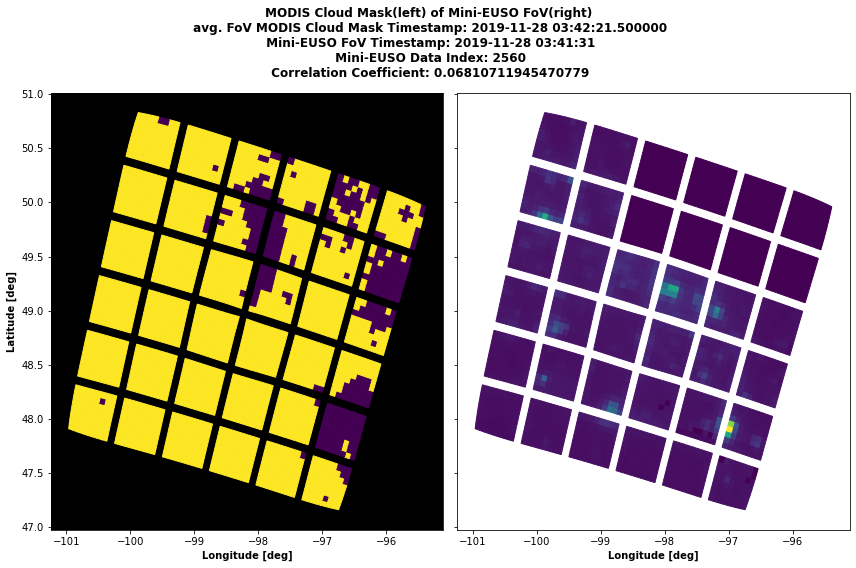

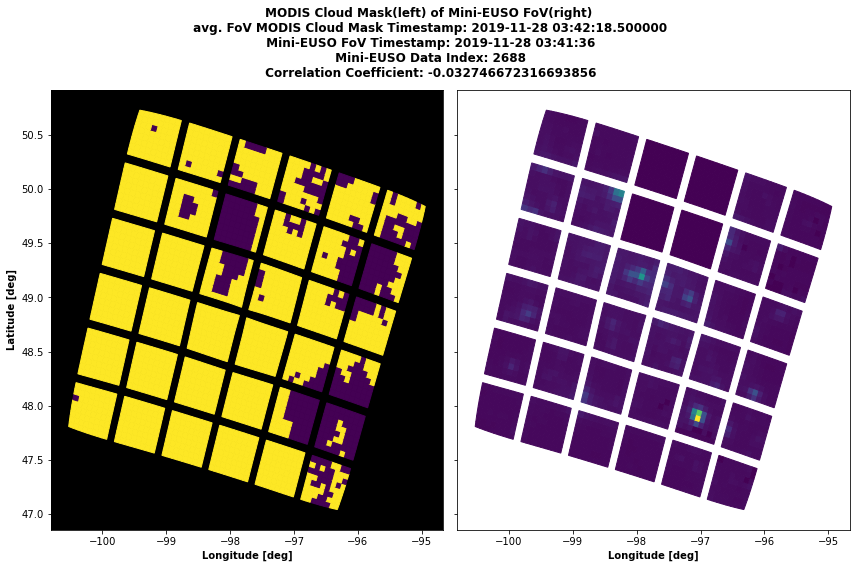

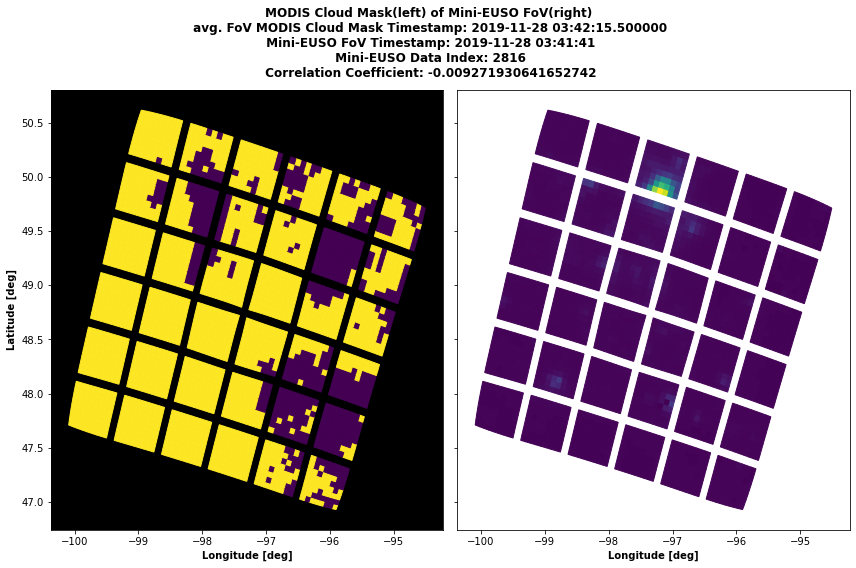

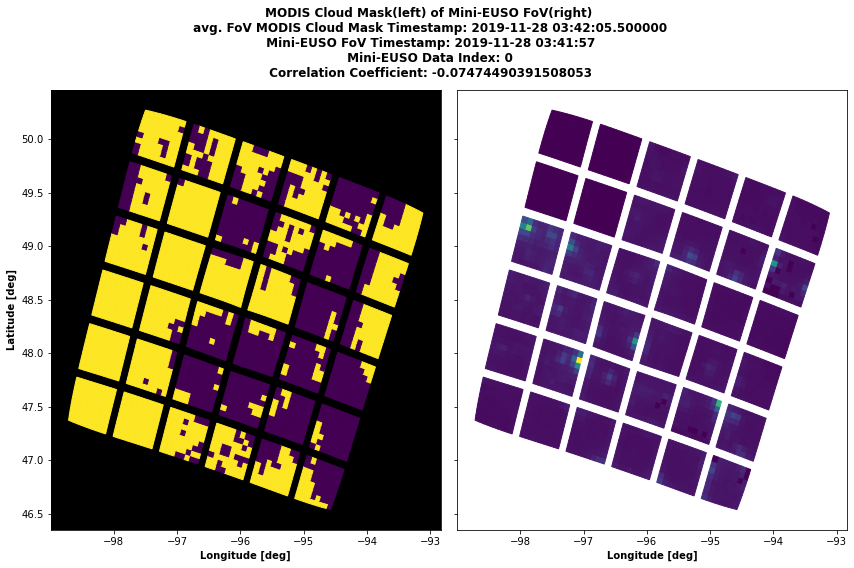

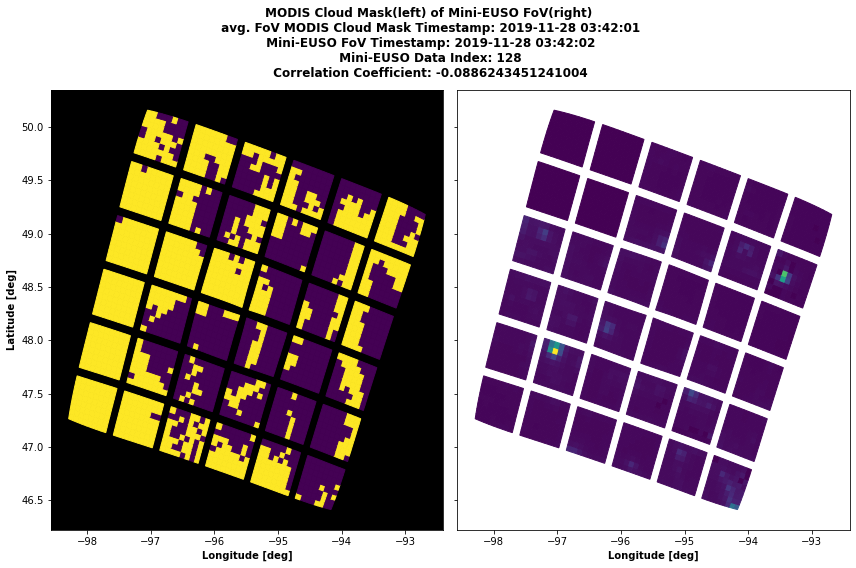

...

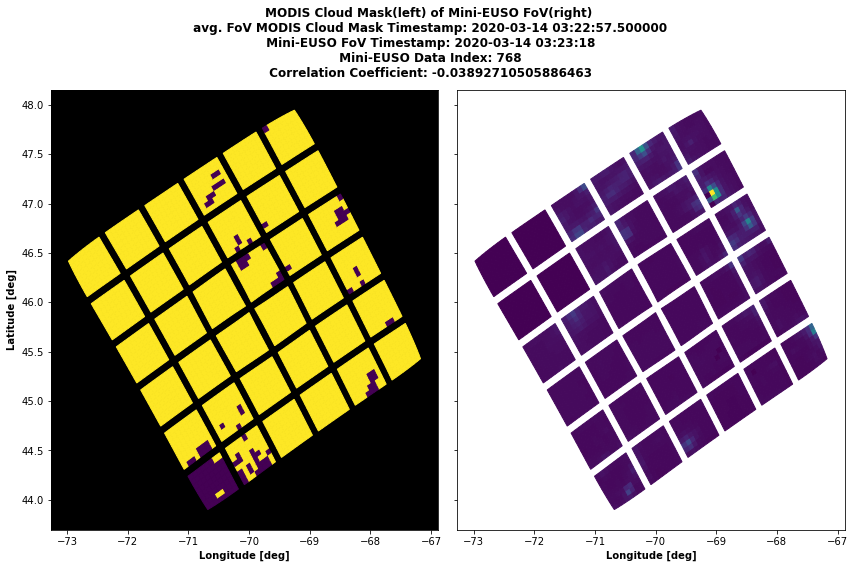

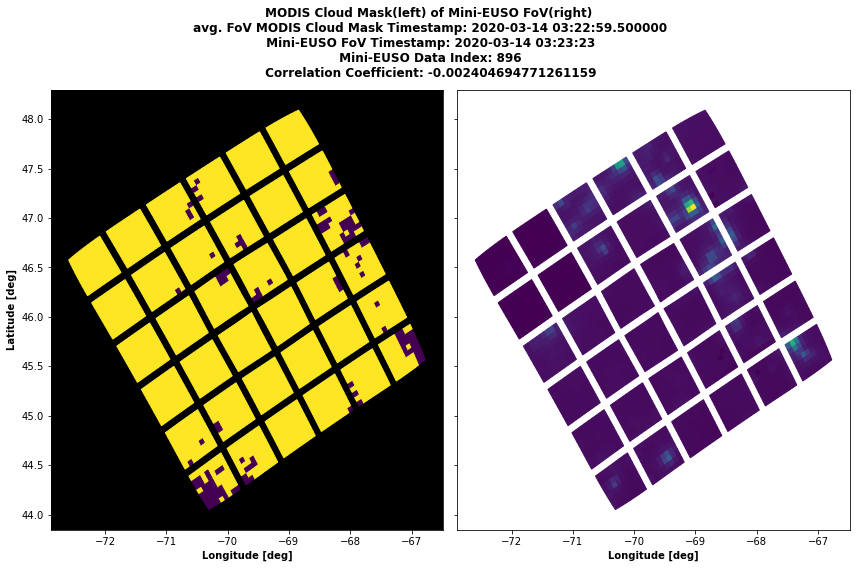

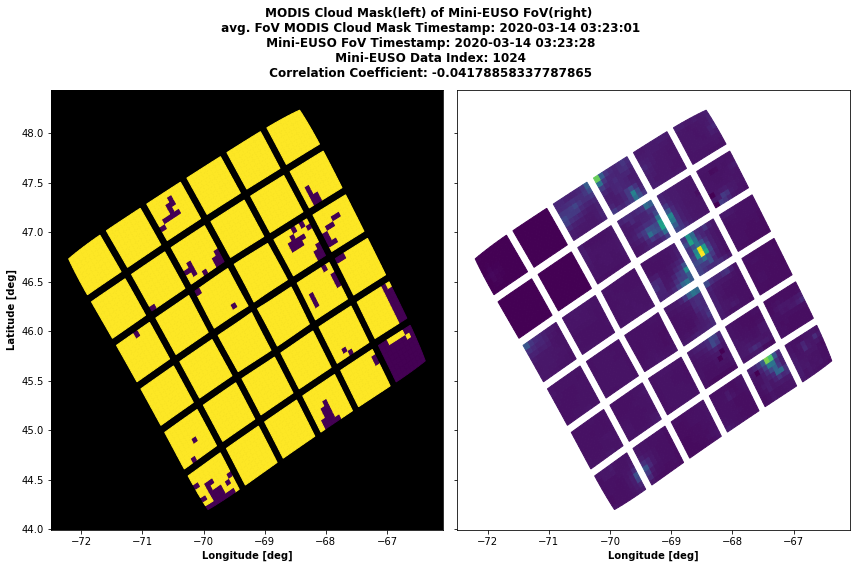

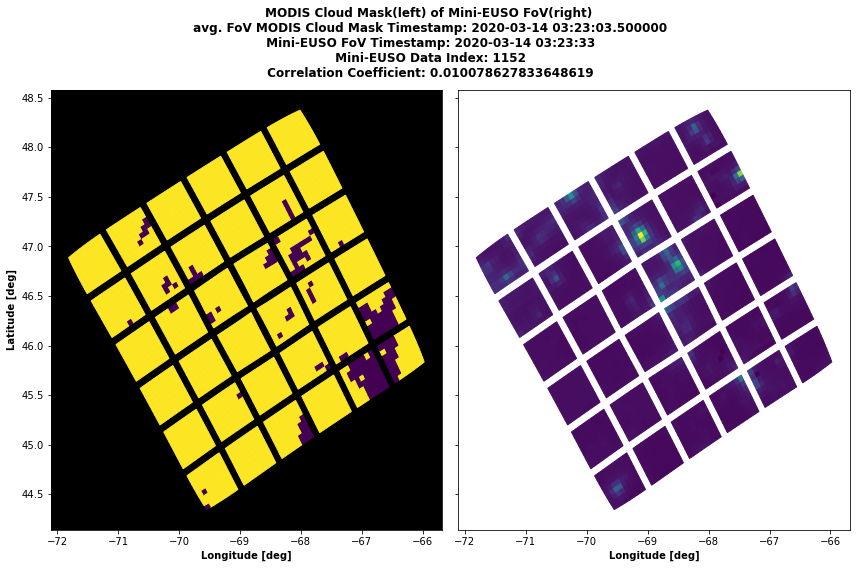

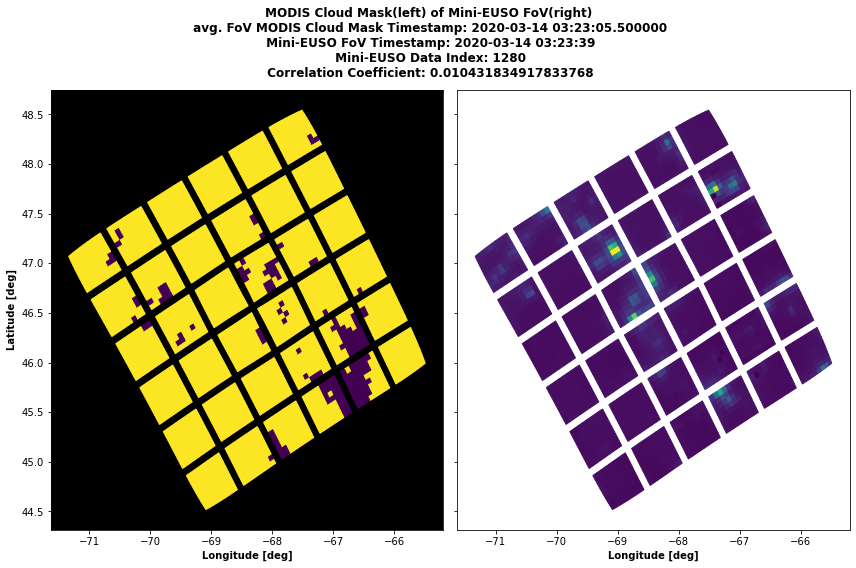

In [32]:
error_ts_list = []

for i in range(len(mapped_cm_list_lt60_ts_list)):
    ts = mapped_cm_list_lt60_ts_list[i]
    mask = mapped_cm_list_lt60_cm_list[i]
    
    modis_time_file = get_modis_files_from_ts(ts)[1]
    minieuso_file = get_minieuso_file_from_ts(ts)
    if minieuso_file == None:
        error_ts_list.append(ts)
        continue

    file_eventsD3 = uproot.open(minieuso_file+':tevent_2nd_integral')
    minieuso_file_ts_arr = file_eventsD3['timestamp_unix'].array(library='np')
    
    try:
        index = np.where(minieuso_file_ts_arr == ts)[0][0]
    except Exception as e:
        error_ts_list.append(ts)      
        continue
        
    try:
        plot_data_side_by_side(modis_time_file, minieuso_file, ts, mask, index)
    except Exception as e:
        error_ts_list.append(ts)
        continue

In [33]:
error_ts_list

[1574912507, 1574912512, 1575582087, 1583174806, 1583180572, 1584156166]